In [ ]:
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader, random_split
from segmentation_models_pytorch.losses import DiceLoss
from segmentation_models_pytorch.metrics.functional import get_stats, iou_score
from tqdm import tqdm
import numpy as np
import seaborn as sns

from dataset import SatelliteImageDataset
from res_unet_a import ResUNetA
from utils import (
    one_hot_to_image,
    plot_prediction,
    compute_accuracy,
    class_index_to_one_hot,
    class_index_to_image,
    get_color_patches,
    print_iou,
    get_iou_by_class
)

torch.manual_seed(20)

In [2]:
dataset = SatelliteImageDataset(
    image_dir='data/images',
    mask_dir='data/masks'
)

In [3]:
train_set, test_set = random_split(dataset, [0.8, 0.2])

In [4]:
img, mask = dataset[0]

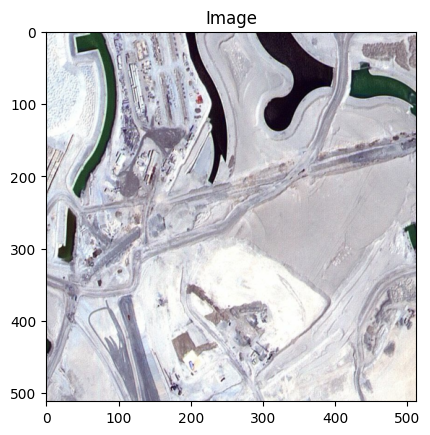

In [5]:
plt.imshow(img.permute(1, 2, 0))
plt.title('Image')
plt.show()

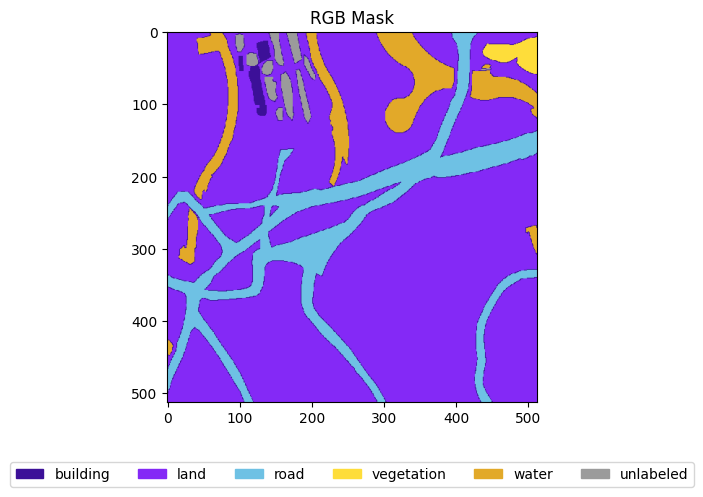

In [6]:
mask_rgb = class_index_to_image(torch.unsqueeze(mask, 0), dataset.color_map)[0]
plt.imshow(mask_rgb.permute(1, 2, 0))

patches = get_color_patches(dataset.color_map, dataset.mask_labels)
plt.legend(handles=patches, loc='lower center', bbox_to_anchor=(0.5, -0.25), fontsize=10, ncol=6)

plt.title('RGB Mask')
plt.show()

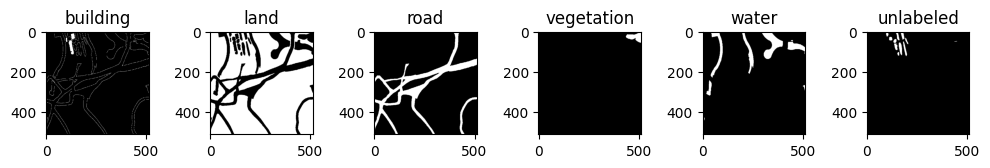

In [7]:
fig, axes = plt.subplots(1, 6, figsize=(10, 8))
mask = class_index_to_one_hot(mask, dataset.color_map)

for i in range(6):
    axes[i].imshow(mask[i], cmap='gray')
    axes[i].set_title(dataset.mask_labels[i])

plt.tight_layout()
plt.show()

In [8]:
train_loader = DataLoader(train_set, shuffle=True)
test_loader = DataLoader(test_set)

In [9]:
LEARNING_RATE = 3e-4
EPOCHS = 100

In [10]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = ResUNetA(in_channels=3, out_channels=6).to(device)

In [11]:
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
criterion = DiceLoss('multiclass').to(device)

Epoch 1:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


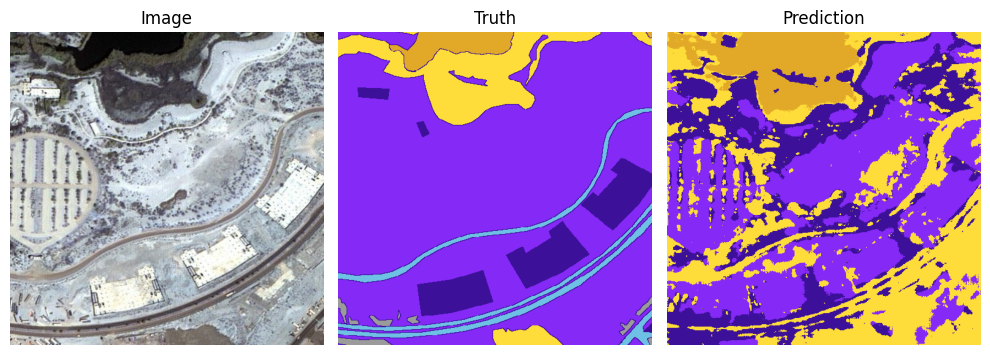

Accuracy: 0.4493 | Loss: 0.5070


Epoch 2:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.83it/s]


Accuracy: 0.5284 | Loss: 0.4412


Epoch 3:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.5632 | Loss: 0.4228


Epoch 4:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.5808 | Loss: 0.4079


Epoch 5:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.5908 | Loss: 0.3975


Epoch 6:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.6146 | Loss: 0.3773


Epoch 7:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.6294 | Loss: 0.3627


Epoch 8:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.6571 | Loss: 0.3475


Epoch 9:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.6767 | Loss: 0.3401


Epoch 10:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.7100 | Loss: 0.3244


Epoch 11:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


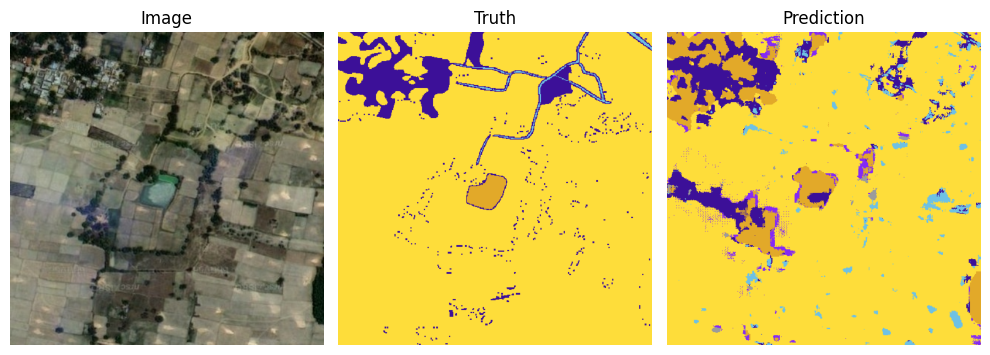

Accuracy: 0.7262 | Loss: 0.3162


Epoch 12:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.83it/s]


Accuracy: 0.7417 | Loss: 0.3078


Epoch 13:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.7553 | Loss: 0.2979


Epoch 14:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.7597 | Loss: 0.2951


Epoch 15:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.7622 | Loss: 0.2928


Epoch 16:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.7712 | Loss: 0.2892


Epoch 17:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.7792 | Loss: 0.2811


Epoch 18:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.7771 | Loss: 0.2787


Epoch 19:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.7855 | Loss: 0.2765


Epoch 20:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.7932 | Loss: 0.2719


Epoch 21:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


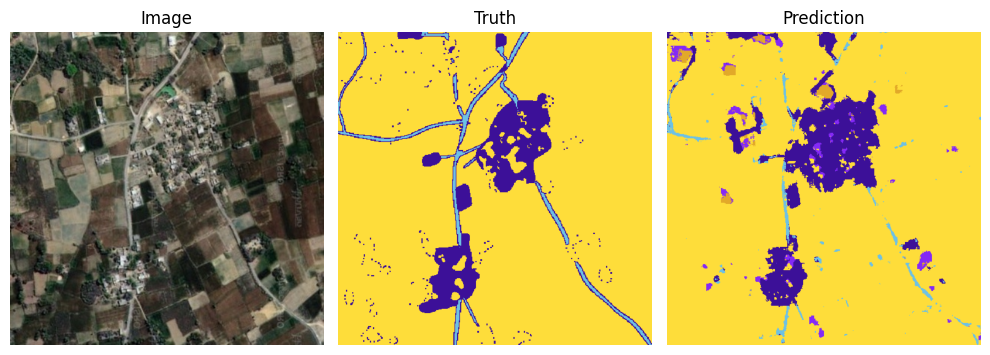

Accuracy: 0.7851 | Loss: 0.2774


Epoch 22:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.7960 | Loss: 0.2678


Epoch 23:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.7982 | Loss: 0.2623


Epoch 24:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8190 | Loss: 0.2502


Epoch 25:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8221 | Loss: 0.2461


Epoch 26:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8065 | Loss: 0.2542


Epoch 27:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8169 | Loss: 0.2468


Epoch 28:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8261 | Loss: 0.2393


Epoch 29:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8278 | Loss: 0.2442


Epoch 30:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8156 | Loss: 0.2517


Epoch 31:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


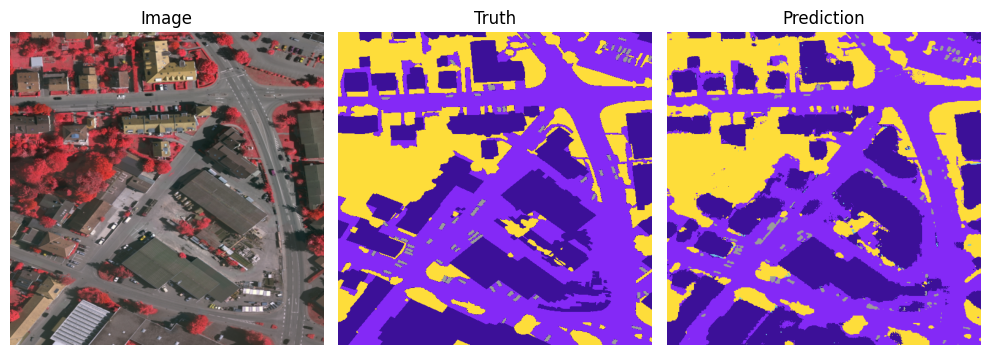

Accuracy: 0.8266 | Loss: 0.2398


Epoch 32:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8377 | Loss: 0.2283


Epoch 33:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8413 | Loss: 0.2253


Epoch 34:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8430 | Loss: 0.2227


Epoch 35:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8365 | Loss: 0.2270


Epoch 36:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8388 | Loss: 0.2252


Epoch 37:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8457 | Loss: 0.2173


Epoch 38:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8364 | Loss: 0.2261


Epoch 39:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8442 | Loss: 0.2140


Epoch 40:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8551 | Loss: 0.2053


Epoch 41:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


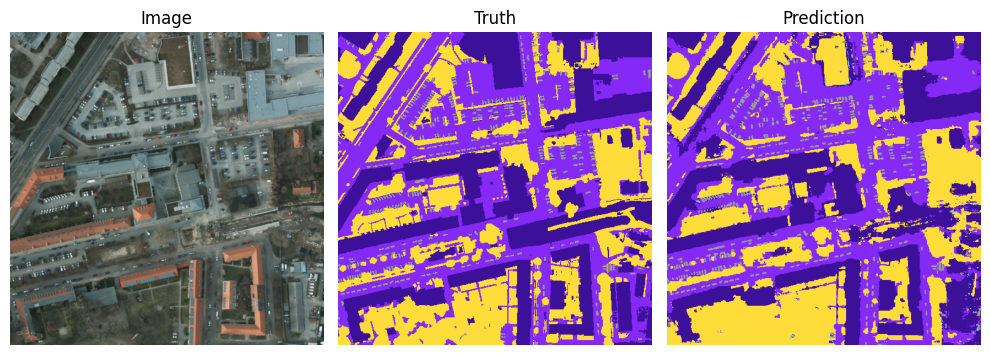

Accuracy: 0.8548 | Loss: 0.2058


Epoch 42:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8481 | Loss: 0.2128


Epoch 43:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.79it/s]


Accuracy: 0.8449 | Loss: 0.2164


Epoch 44:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8528 | Loss: 0.2056


Epoch 45:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8572 | Loss: 0.2031


Epoch 46:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8568 | Loss: 0.2020


Epoch 47:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.79it/s]


Accuracy: 0.8589 | Loss: 0.1993


Epoch 48:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8616 | Loss: 0.1956


Epoch 49:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8635 | Loss: 0.1935


Epoch 50:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8663 | Loss: 0.1894


Epoch 51:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


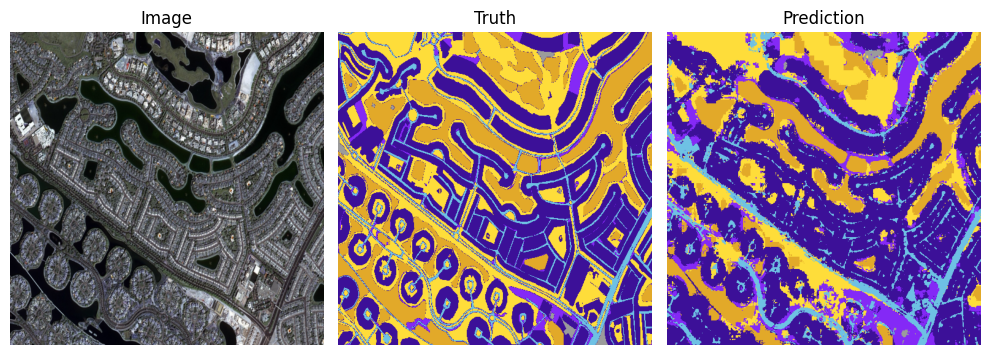

Accuracy: 0.8687 | Loss: 0.1878


Epoch 52:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8645 | Loss: 0.1914


Epoch 53:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8425 | Loss: 0.2171


Epoch 54:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8578 | Loss: 0.1982


Epoch 55:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8680 | Loss: 0.1878


Epoch 56:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8709 | Loss: 0.1842


Epoch 57:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8693 | Loss: 0.1877


Epoch 58:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8698 | Loss: 0.1867


Epoch 59:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8721 | Loss: 0.1826


Epoch 60:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8667 | Loss: 0.1858


Epoch 61:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


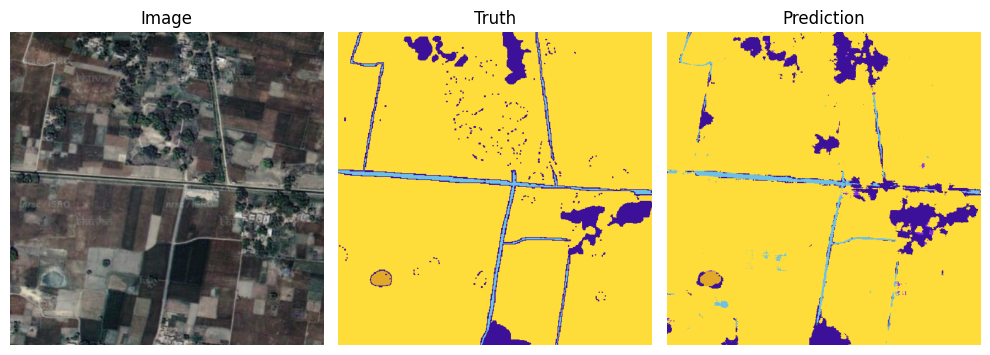

Accuracy: 0.8693 | Loss: 0.1862


Epoch 62:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8749 | Loss: 0.1801


Epoch 63:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8719 | Loss: 0.1804


Epoch 64:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8764 | Loss: 0.1783


Epoch 65:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8680 | Loss: 0.1880


Epoch 66:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.82it/s]


Accuracy: 0.8717 | Loss: 0.1850


Epoch 67:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8798 | Loss: 0.1719


Epoch 68:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8799 | Loss: 0.1713


Epoch 69:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8808 | Loss: 0.1688


Epoch 70:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8744 | Loss: 0.1767


Epoch 71:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


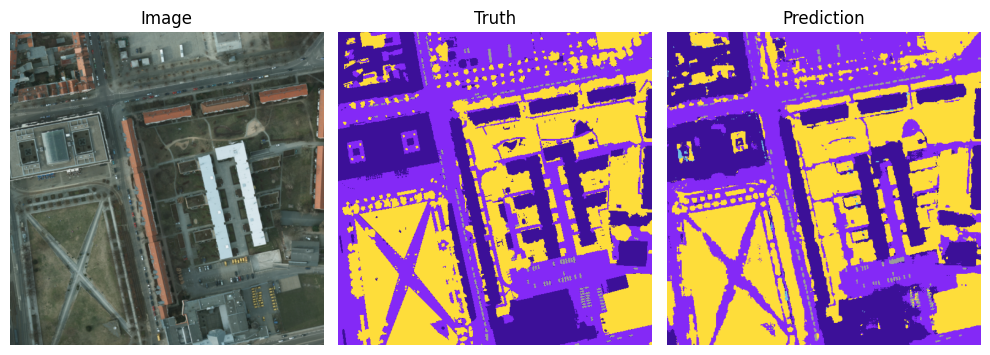

Accuracy: 0.8613 | Loss: 0.1912


Epoch 72:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8748 | Loss: 0.1779


Epoch 73:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8792 | Loss: 0.1707


Epoch 74:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8863 | Loss: 0.1627


Epoch 75:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8869 | Loss: 0.1608


Epoch 76:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8895 | Loss: 0.1582


Epoch 77:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8871 | Loss: 0.1595


Epoch 78:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.79it/s]


Accuracy: 0.8879 | Loss: 0.1598


Epoch 79:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8798 | Loss: 0.1672


Epoch 80:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8821 | Loss: 0.1666


Epoch 81:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


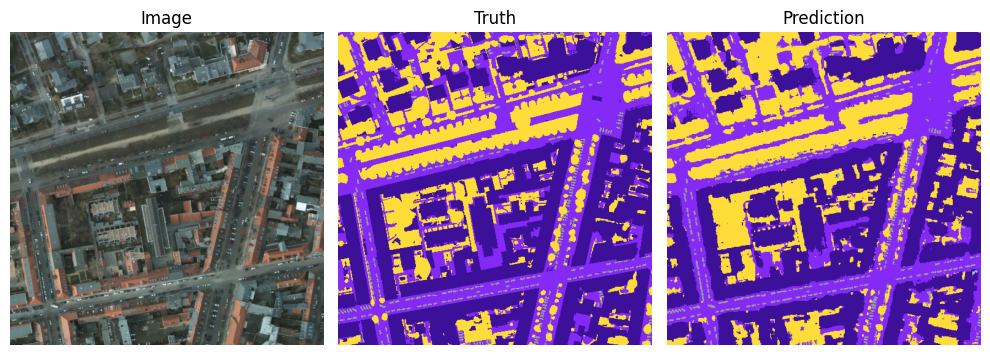

Accuracy: 0.8822 | Loss: 0.1652


Epoch 82:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8890 | Loss: 0.1584


Epoch 83:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8907 | Loss: 0.1559


Epoch 84:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.80it/s]


Accuracy: 0.8869 | Loss: 0.1612


Epoch 85:


Training: 100%|██████████| 163/163 [00:57<00:00,  2.81it/s]


Accuracy: 0.8860 | Loss: 0.1602


Epoch 86:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8893 | Loss: 0.1591


Epoch 87:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.81it/s]


Accuracy: 0.8892 | Loss: 0.1578


Epoch 88:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.79it/s]


Accuracy: 0.8928 | Loss: 0.1523


Epoch 89:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.79it/s]


Accuracy: 0.8881 | Loss: 0.1577


Epoch 90:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.79it/s]


Accuracy: 0.8872 | Loss: 0.1579


Epoch 91:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


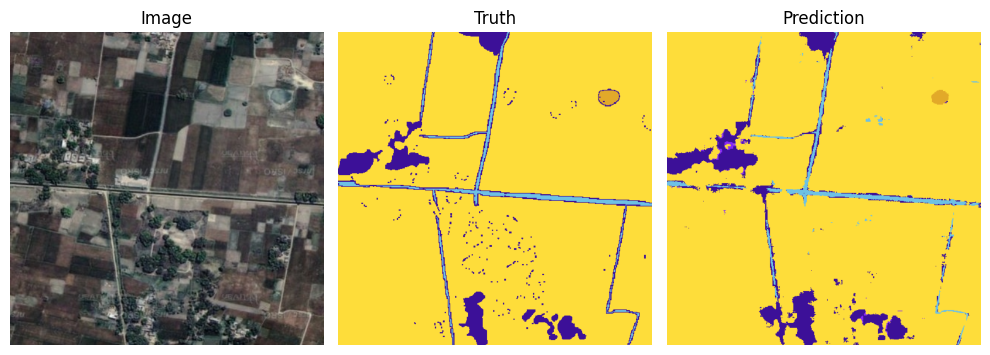

Accuracy: 0.8904 | Loss: 0.1534


Epoch 92:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8918 | Loss: 0.1529


Epoch 93:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.8975 | Loss: 0.1451


Epoch 94:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.8879 | Loss: 0.1615


Epoch 95:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8852 | Loss: 0.1605


Epoch 96:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]


Accuracy: 0.8972 | Loss: 0.1461


Epoch 97:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.9000 | Loss: 0.1420


Epoch 98:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.78it/s]


Accuracy: 0.9000 | Loss: 0.1421


Epoch 99:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.76it/s]


Accuracy: 0.9000 | Loss: 0.1415


Epoch 100:


Training: 100%|██████████| 163/163 [00:58<00:00,  2.77it/s]

Accuracy: 0.9016 | Loss: 0.1414




In [12]:
loss_list = []
acc_list = []

for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}:')

    model.train()
    running_loss = 0
    running_acc = 0

    for x, y in tqdm(train_loader, desc='Training', colour='#00FF00'):
        x, y = x.to(device), y.to(device) # y: (b, h, w)
        y_pred = model(x) # y_pred: (b, 6, h, w)

        loss = criterion(y_pred, y)
        running_loss += loss.item()

        # compute the accuracy of the prediction
        running_acc += compute_accuracy(y, y_pred, device)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    if epoch % 10 == 0:
        # show first image in the last batch with matplotlib
        y_imgs = class_index_to_image(y, dataset.color_map, device)
        pred_imgs = one_hot_to_image(y_pred, dataset.color_map, device)
        plot_prediction(x, y_imgs, pred_imgs, dataset.color_map, dataset.mask_labels)

    epoch_acc = running_acc / len(train_loader)
    epoch_loss = running_loss / len(train_loader)
    acc_list.append(epoch_acc)
    loss_list.append(epoch_loss)

    print(f'Accuracy: {epoch_acc:.4f} | Loss: {epoch_loss:.4f}')
    print('\n')


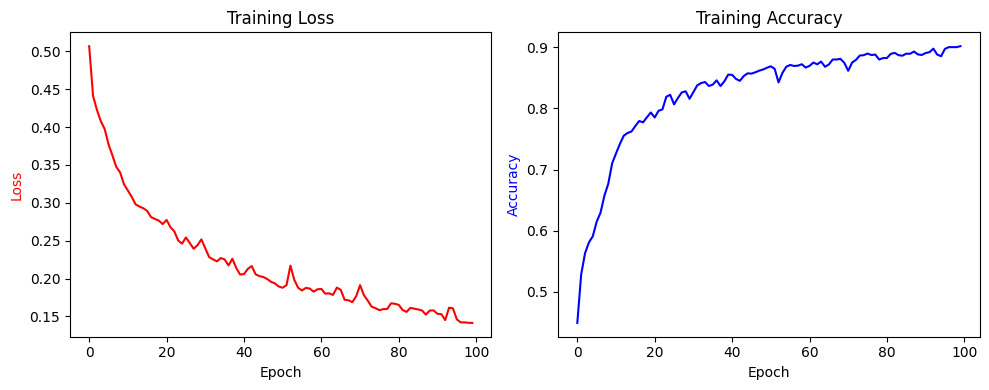

In [13]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].plot(loss_list, color='red')
axes[0].set_ylabel('Loss', color='red')
axes[0].set_xlabel('Epoch')
axes[0].set_title('Training Loss')

axes[1].plot(acc_list, color='blue')
axes[1].set_ylabel('Accuracy', color='blue')
axes[1].set_xlabel('Epoch')
axes[1].set_title('Training Accuracy')

plt.tight_layout()
plt.show()

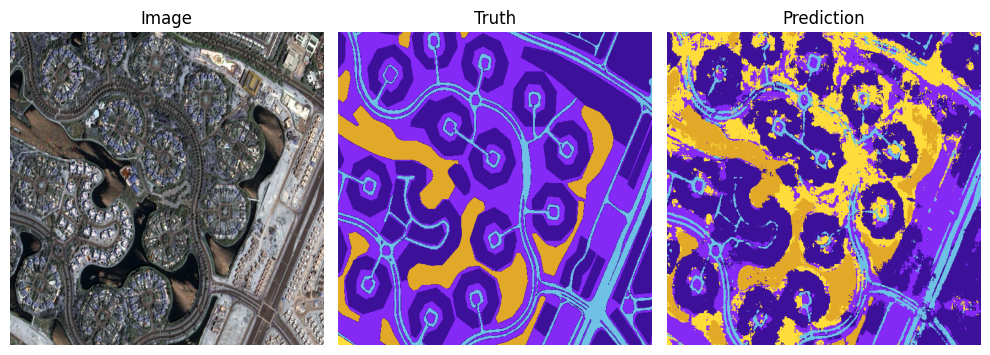

Accuracy: 0.6341 | Loss: 0.3544
IOU... building: 0.62 land: 0.37 road: 0.53 vegetation: 0.00 water: 0.79 




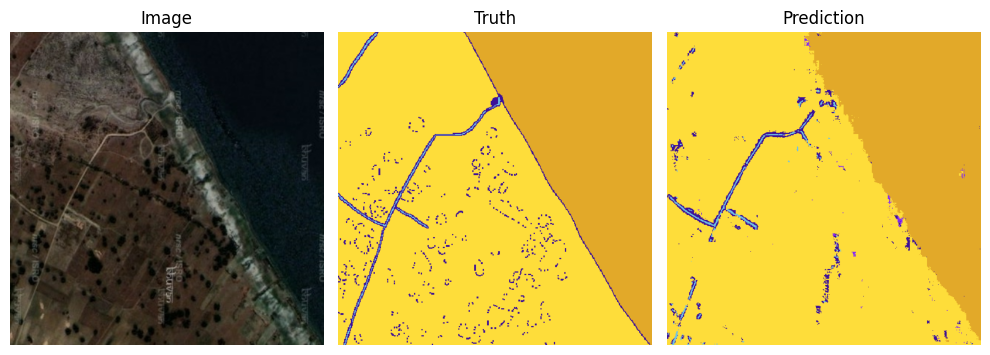

Accuracy: 0.9451 | Loss: 0.2299
IOU... building: 0.12 road: 0.30 vegetation: 0.93 water: 0.96 unlabeled: 1.00 




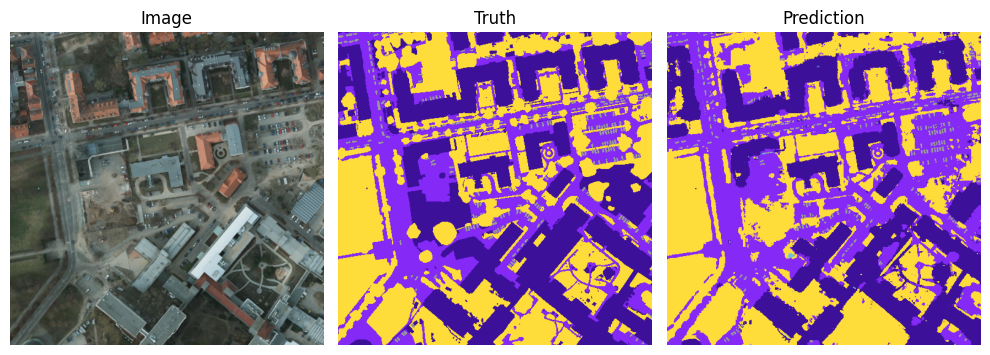

Accuracy: 0.8031 | Loss: 0.1473
IOU... building: 0.69 land: 0.61 vegetation: 0.72 unlabeled: 0.55 




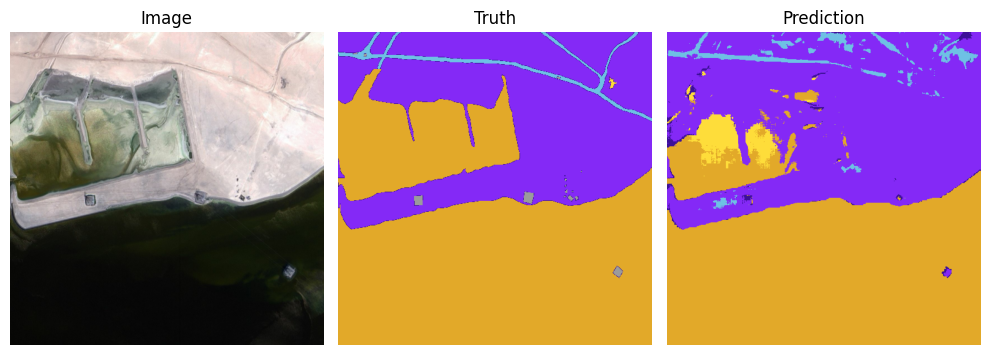

Accuracy: 0.8648 | Loss: 0.6137
IOU... building: 0.04 land: 0.78 road: 0.29 water: 0.83 unlabeled: 0.00 




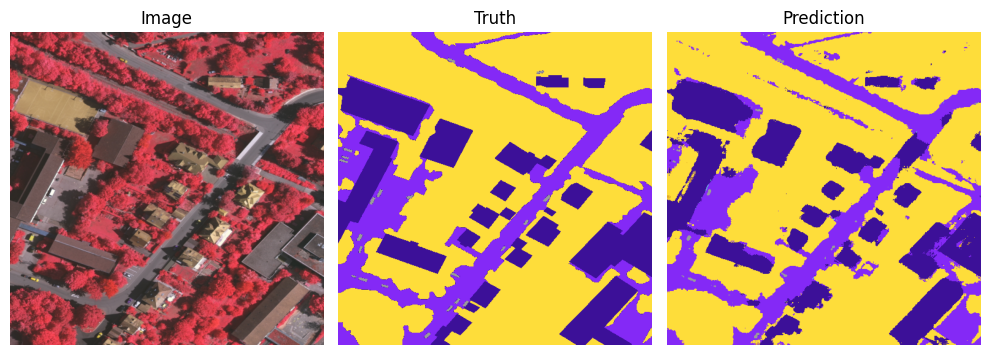

Accuracy: 0.9010 | Loss: 0.1493
IOU... building: 0.77 land: 0.67 vegetation: 0.90 unlabeled: 0.33 




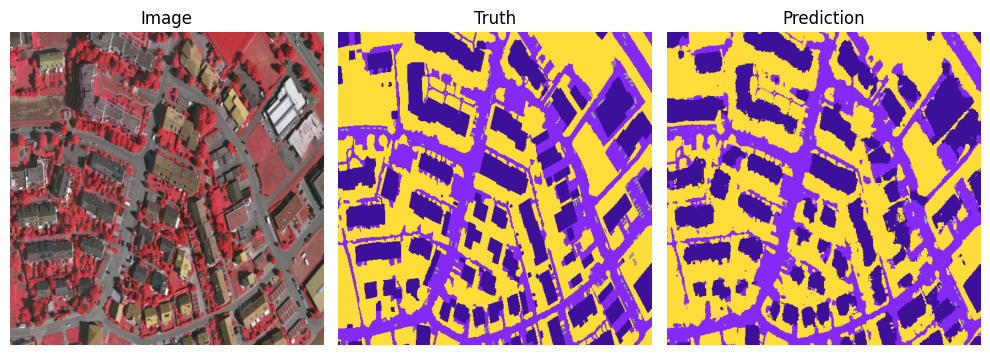

Accuracy: 0.8590 | Loss: 0.1923
IOU... building: 0.69 land: 0.70 vegetation: 0.83 unlabeled: 0.18 




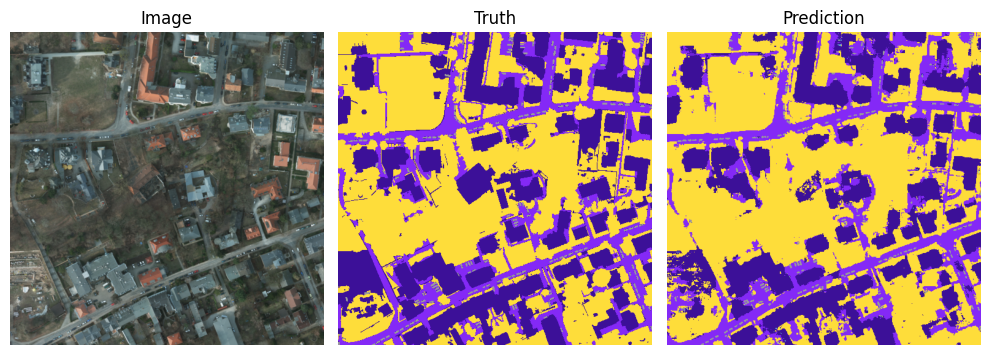

Accuracy: 0.8276 | Loss: 0.1547
IOU... building: 0.68 land: 0.54 vegetation: 0.81 unlabeled: 0.51 




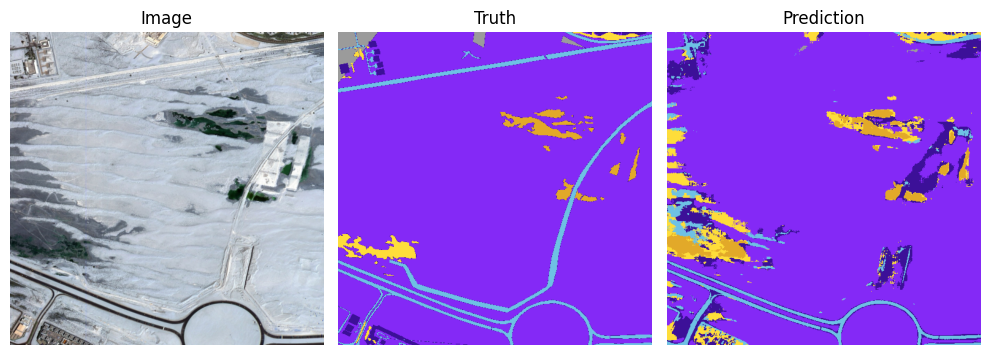

Accuracy: 0.8234 | Loss: 0.6120
IOU... building: 0.09 land: 0.84 road: 0.28 vegetation: 0.10 water: 0.46 




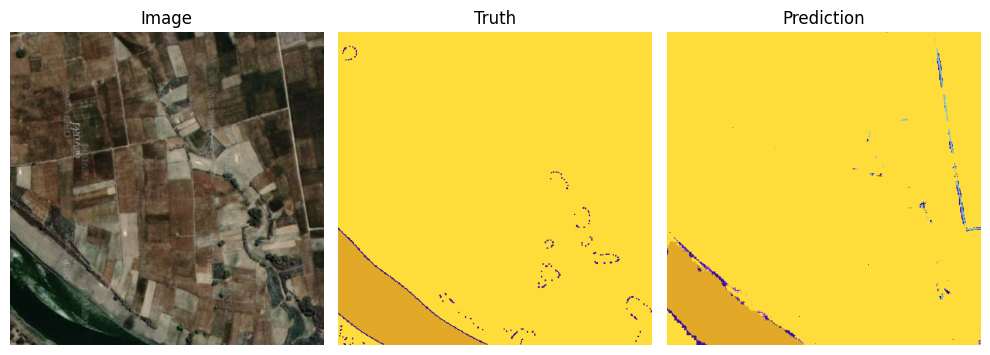

Accuracy: 0.9806 | Loss: 0.1628
IOU... building: 0.05 vegetation: 0.98 water: 0.89 unlabeled: 1.00 




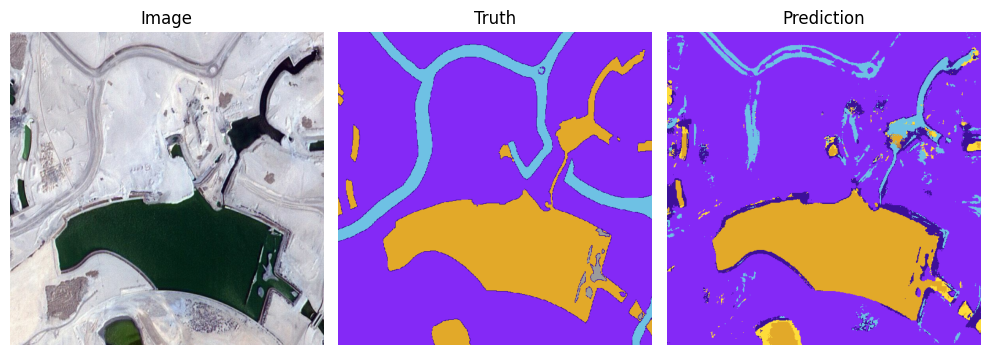

Accuracy: 0.8392 | Loss: 0.4444
IOU... building: 0.10 land: 0.84 road: 0.20 water: 0.84 




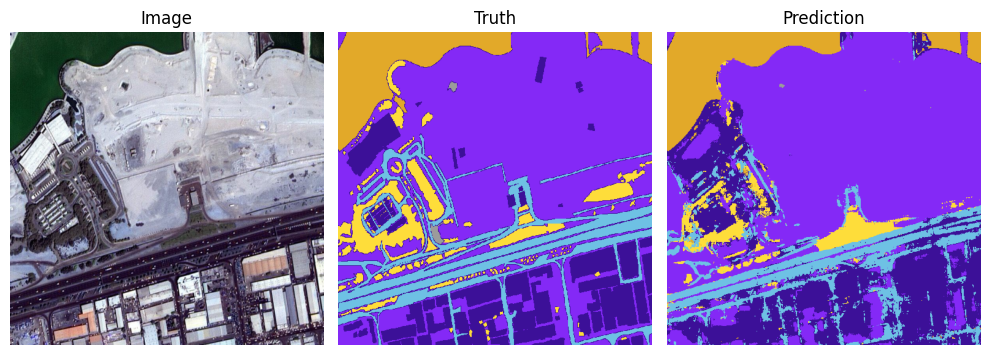

Accuracy: 0.7383 | Loss: 0.3861
IOU... building: 0.41 land: 0.69 road: 0.46 vegetation: 0.37 water: 0.96 unlabeled: 0.08 




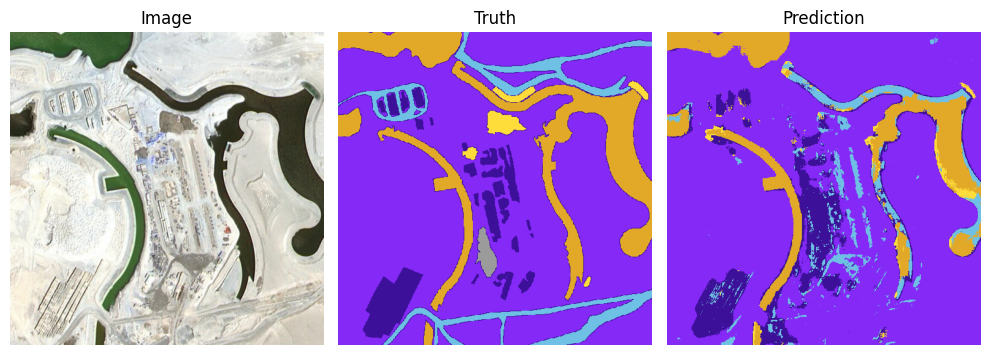

Accuracy: 0.7924 | Loss: 0.6083
IOU... building: 0.35 land: 0.82 road: 0.01 vegetation: 0.04 water: 0.71 




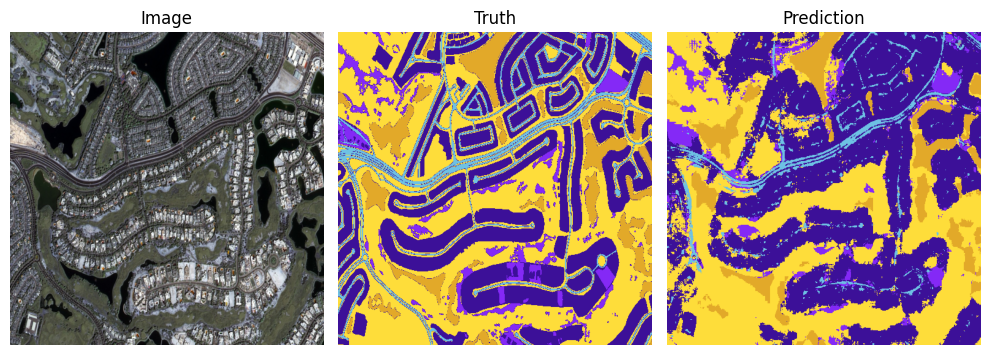

Accuracy: 0.7280 | Loss: 0.2813
IOU... building: 0.59 land: 0.28 road: 0.32 vegetation: 0.60 water: 0.82 




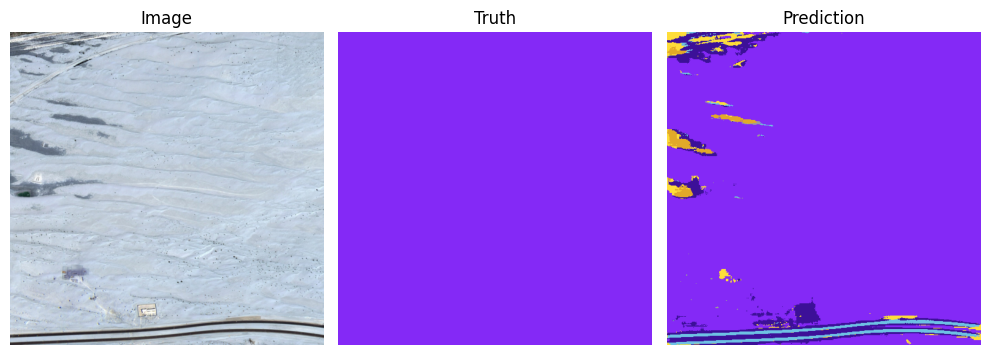

Accuracy: 0.9032 | Loss: 0.0085
IOU... land: 0.90 




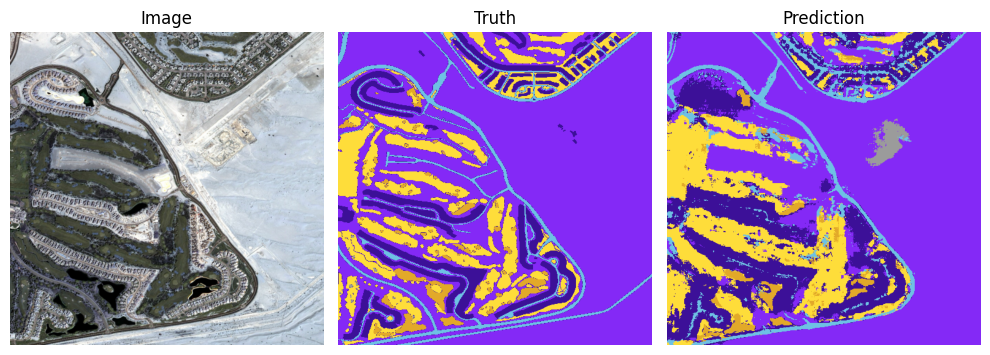

Accuracy: 0.7363 | Loss: 0.4716
IOU... building: 0.41 land: 0.72 road: 0.33 vegetation: 0.55 water: 0.39 




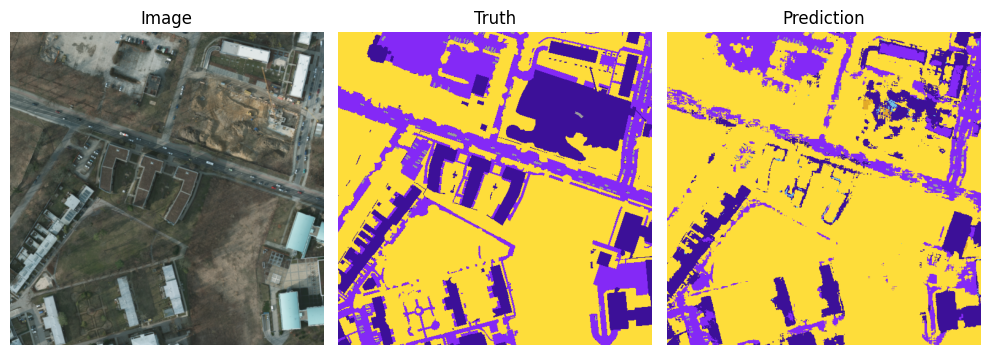

Accuracy: 0.7721 | Loss: 0.2246
IOU... building: 0.41 land: 0.46 vegetation: 0.76 unlabeled: 0.41 




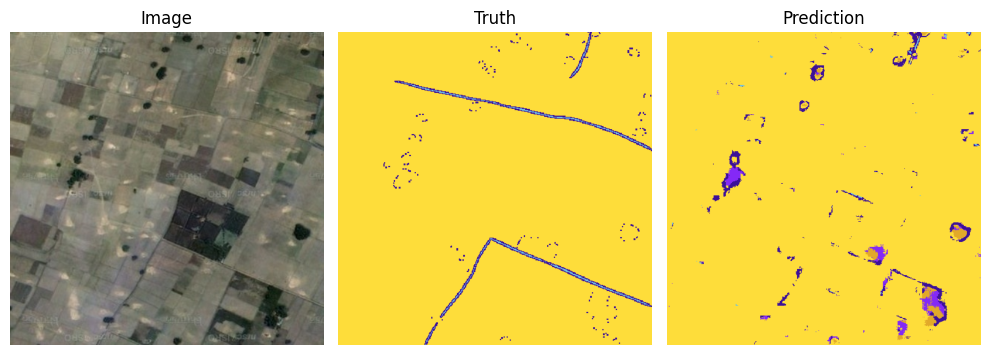

Accuracy: 0.9521 | Loss: 0.2968
IOU... building: 0.11 road: 0.03 vegetation: 0.95 




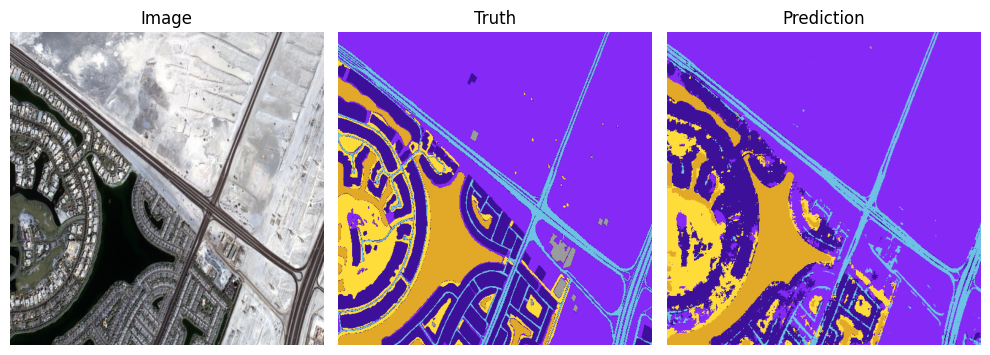

Accuracy: 0.8335 | Loss: 0.3477
IOU... building: 0.51 land: 0.85 road: 0.59 vegetation: 0.46 water: 0.91 




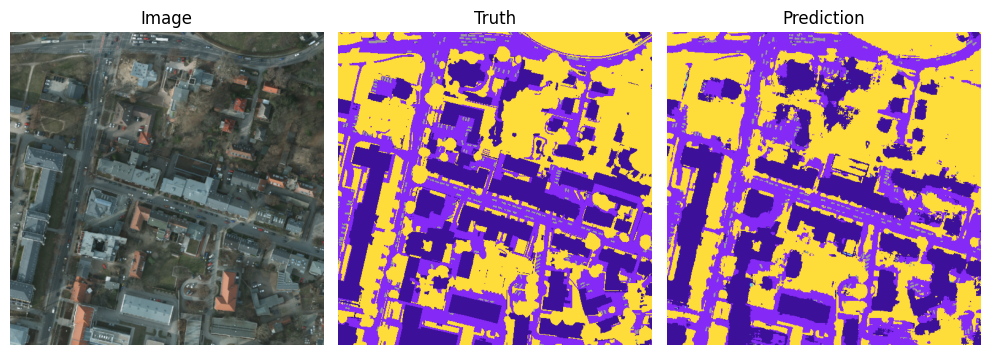

Accuracy: 0.8129 | Loss: 0.1477
IOU... building: 0.67 land: 0.63 vegetation: 0.74 unlabeled: 0.52 




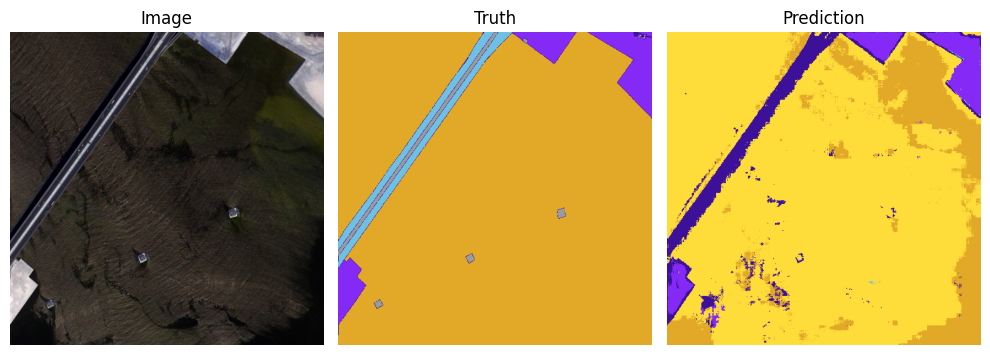

Accuracy: 0.1867 | Loss: 0.6153
IOU... building: 0.07 land: 0.81 road: 0.00 water: 0.16 unlabeled: 0.00 




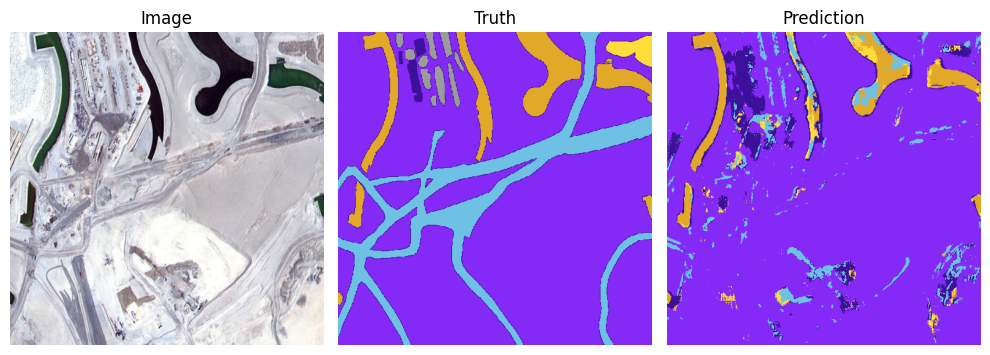

Accuracy: 0.7389 | Loss: 0.6747
IOU... building: 0.13 land: 0.76 road: 0.05 vegetation: 0.02 water: 0.59 unlabeled: 0.00 




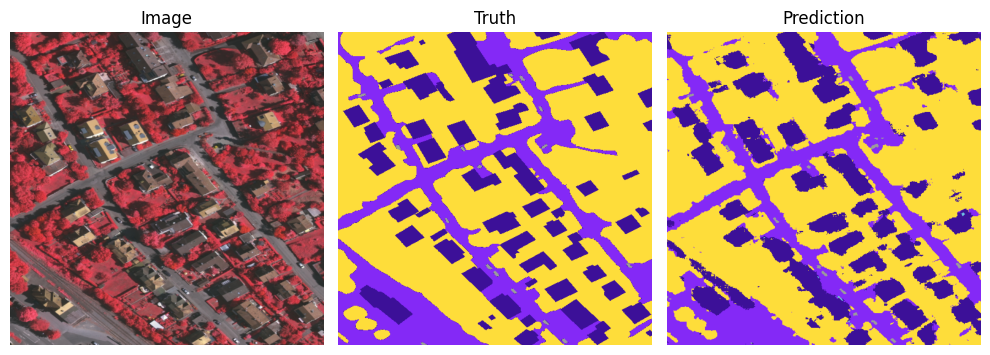

Accuracy: 0.8828 | Loss: 0.1173
IOU... building: 0.70 land: 0.70 vegetation: 0.87 water: 1.00 unlabeled: 0.57 




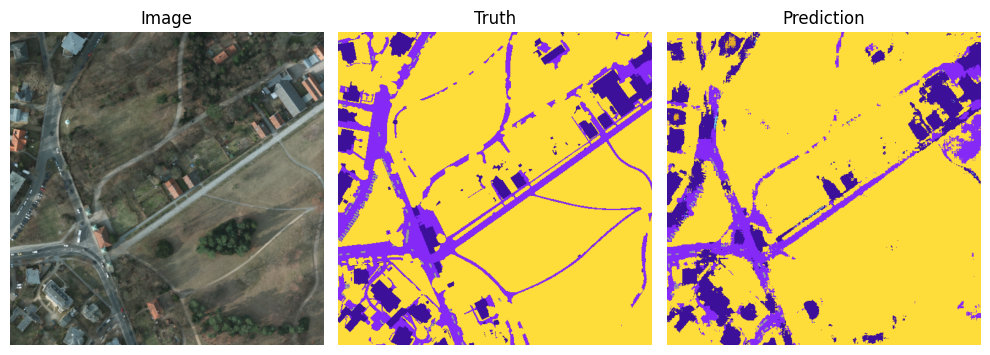

Accuracy: 0.8594 | Loss: 0.2258
IOU... building: 0.49 land: 0.37 vegetation: 0.88 unlabeled: 0.35 




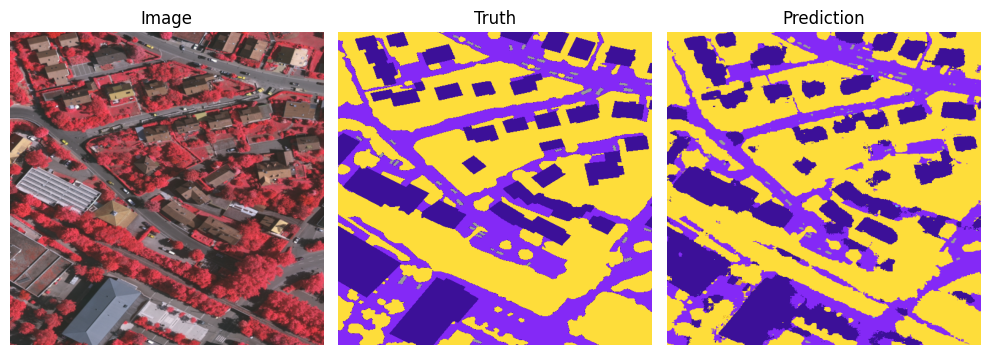

Accuracy: 0.8608 | Loss: 0.1491
IOU... building: 0.69 land: 0.65 vegetation: 0.85 unlabeled: 0.41 




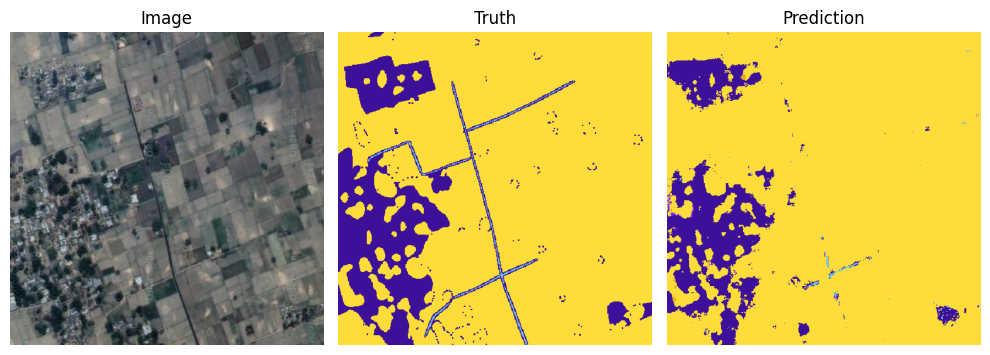

Accuracy: 0.9207 | Loss: 0.1870
IOU... building: 0.60 road: 0.10 vegetation: 0.91 unlabeled: 1.00 




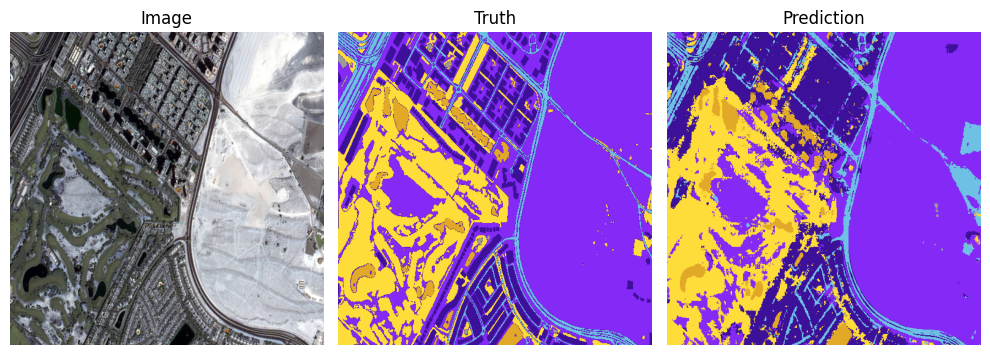

Accuracy: 0.7457 | Loss: 0.4093
IOU... building: 0.41 land: 0.68 road: 0.43 vegetation: 0.65 water: 0.62 




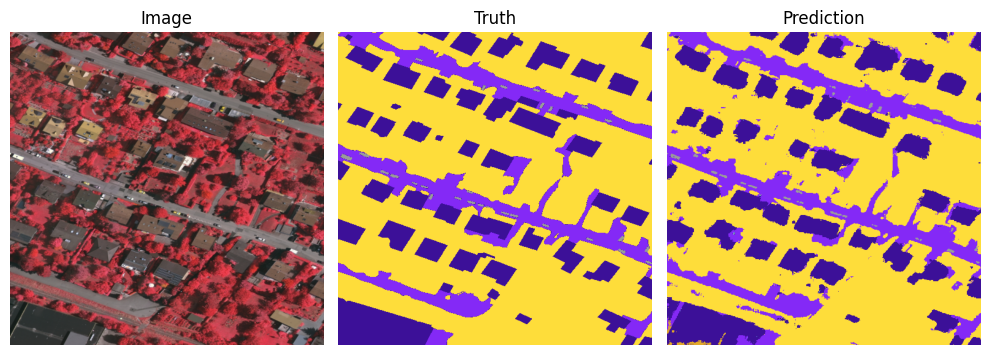

Accuracy: 0.9124 | Loss: 0.1144
IOU... building: 0.78 land: 0.70 vegetation: 0.90 unlabeled: 0.50 




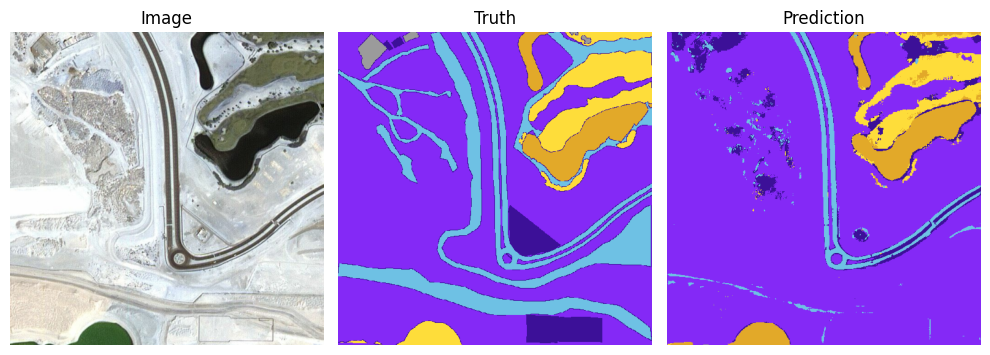

Accuracy: 0.7135 | Loss: 0.5341
IOU... building: 0.08 land: 0.71 road: 0.19 vegetation: 0.58 water: 0.64 




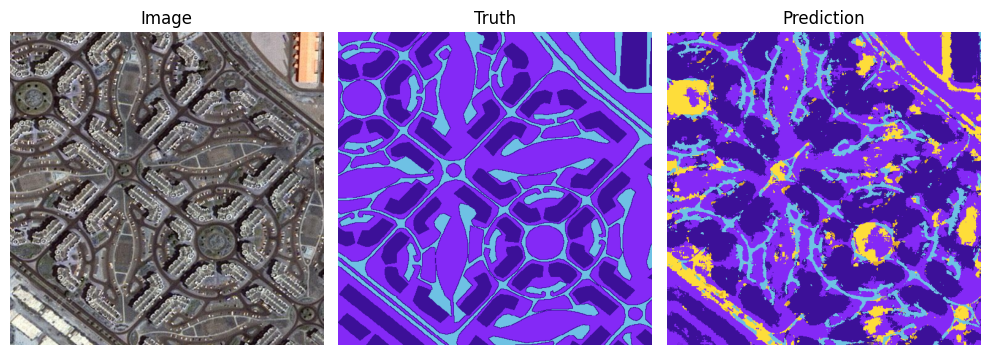

Accuracy: 0.6316 | Loss: 0.1841
IOU... building: 0.53 land: 0.52 road: 0.35 




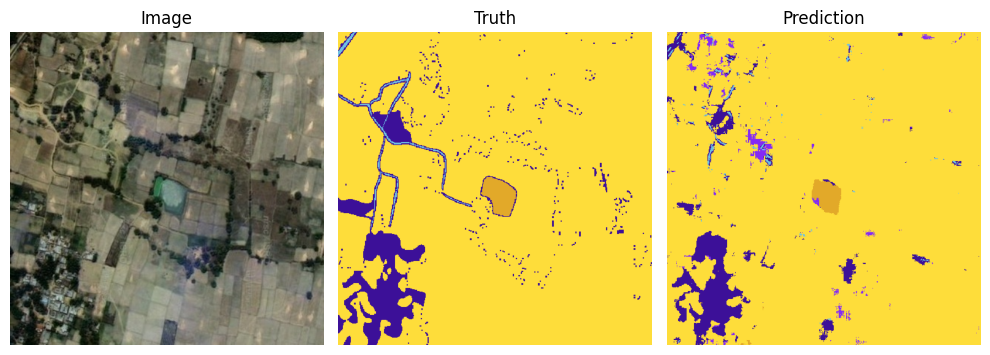

Accuracy: 0.9274 | Loss: 0.2385
IOU... building: 0.42 road: 0.10 vegetation: 0.93 water: 0.73 unlabeled: 1.00 




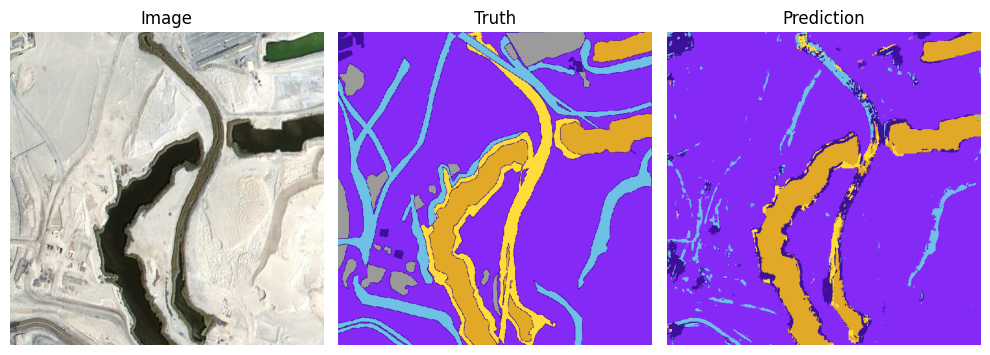

Accuracy: 0.7248 | Loss: 0.6002
IOU... building: 0.09 land: 0.74 road: 0.13 vegetation: 0.14 water: 0.83 




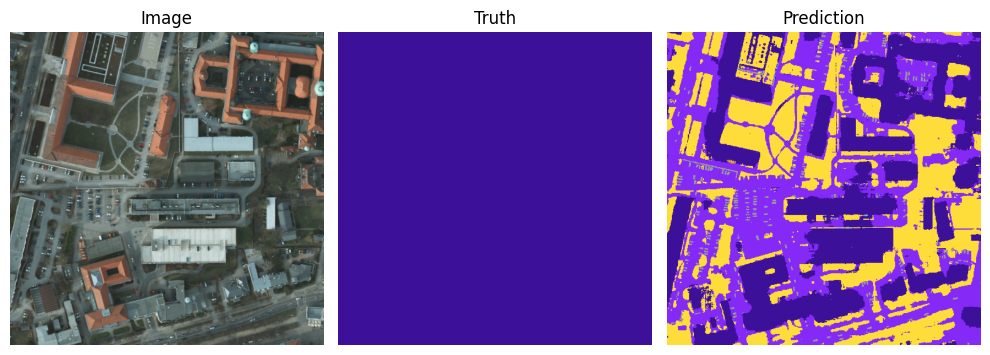

Accuracy: 0.3218 | Loss: 0.0855
IOU... building: 0.32 




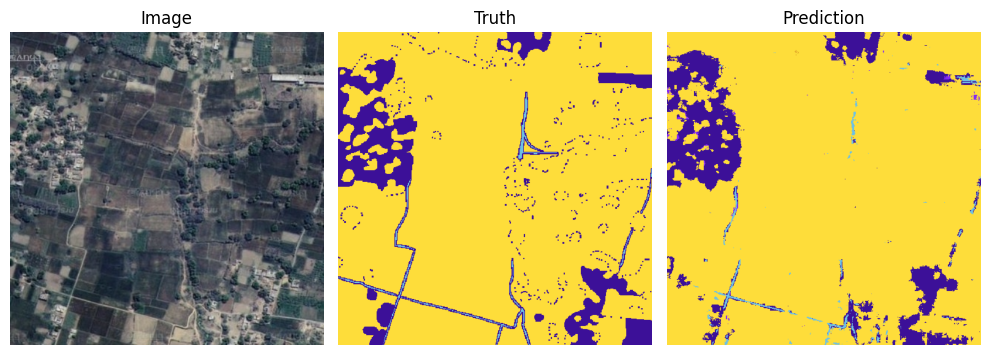

Accuracy: 0.9055 | Loss: 0.1709
IOU... building: 0.47 road: 0.24 vegetation: 0.90 




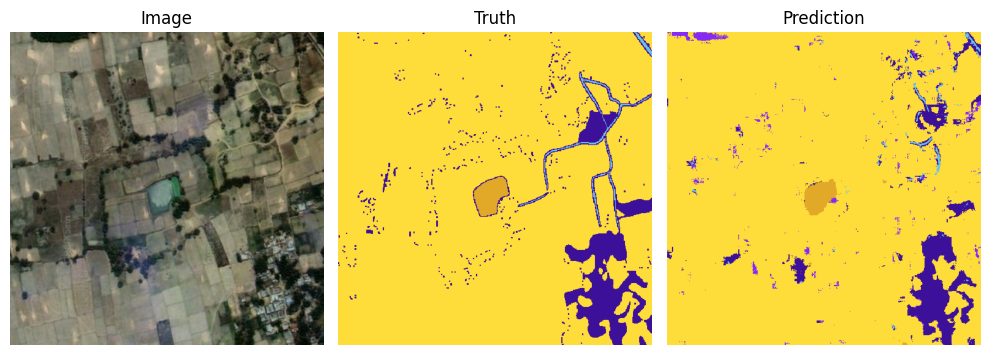

Accuracy: 0.9273 | Loss: 0.2167
IOU... building: 0.42 road: 0.15 vegetation: 0.93 water: 0.81 




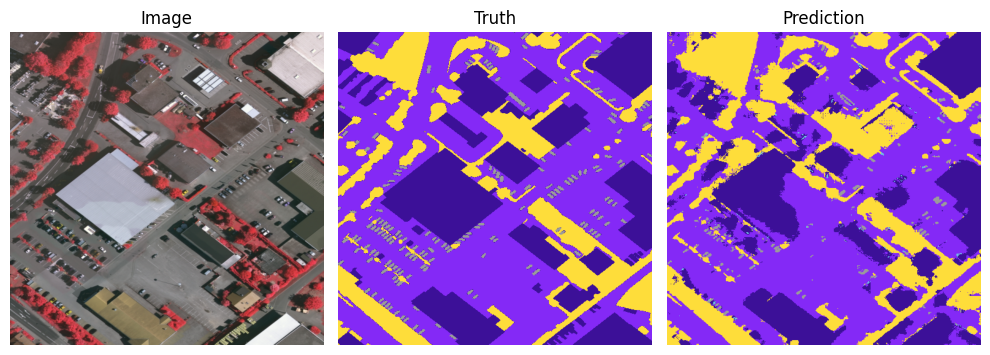

Accuracy: 0.7988 | Loss: 0.1975
IOU... building: 0.58 land: 0.72 vegetation: 0.69 unlabeled: 0.27 




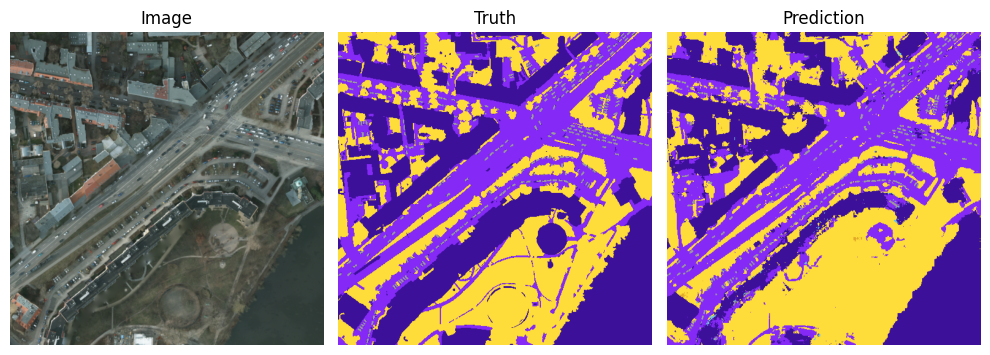

Accuracy: 0.7948 | Loss: 0.1579
IOU... building: 0.66 land: 0.63 vegetation: 0.70 unlabeled: 0.50 




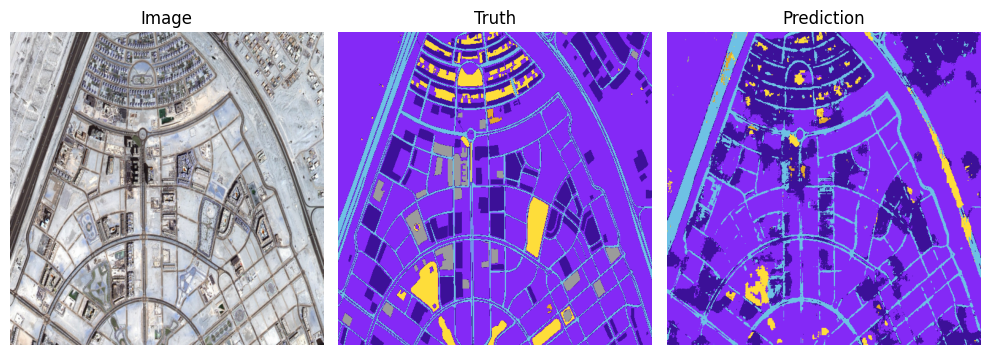

Accuracy: 0.7331 | Loss: 0.5456
IOU... building: 0.39 land: 0.73 road: 0.50 vegetation: 0.20 water: 0.19 unlabeled: 0.00 




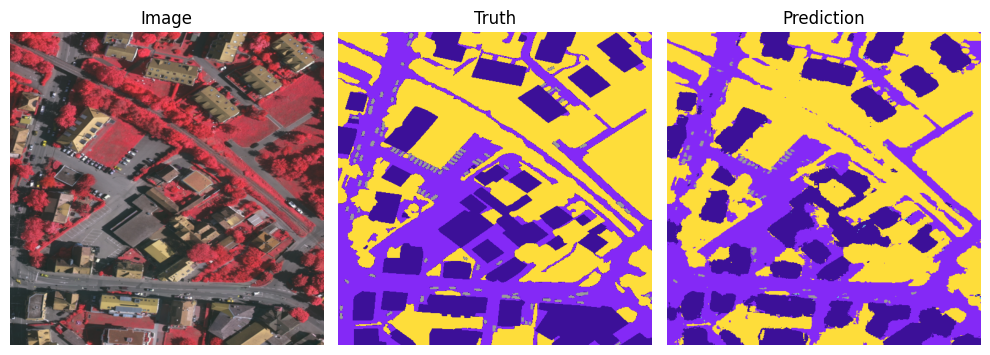

Accuracy: 0.8905 | Loss: 0.1477
IOU... building: 0.77 land: 0.76 vegetation: 0.88 unlabeled: 0.29 




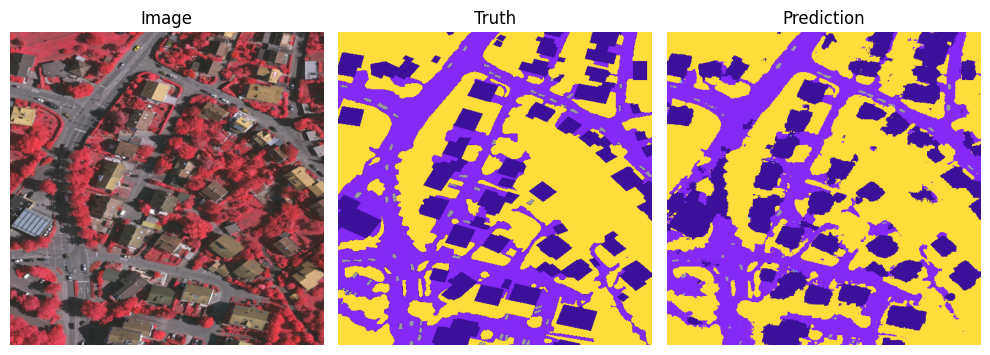

Accuracy: 0.8693 | Loss: 0.1601
IOU... building: 0.67 land: 0.72 vegetation: 0.85 water: 1.00 unlabeled: 0.31 




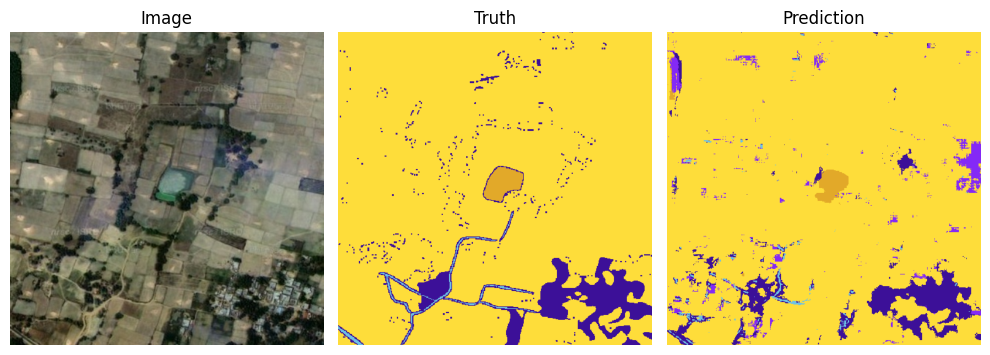

Accuracy: 0.9109 | Loss: 0.2480
IOU... building: 0.40 road: 0.11 vegetation: 0.91 water: 0.64 




In [14]:
test_acc_list = []
iou_list = torch.tensor([])
count = 0

with torch.no_grad():
    for x, y in test_loader:
        x, y = x.to(device), y.to(device) # y: (b, h, w)
        y_pred = model(x) # y_pred: (b, 6, h, w)

        loss = criterion(y_pred, y)

        # compute accuracy 
        acc = compute_accuracy(y, y_pred, device)
        test_acc_list.append(acc.item())

        # compute iou scores 
        y_pred_argmax = torch.argmax(y_pred, 1)
        tp, fp, fn, tn = get_stats(y_pred_argmax, y, mode='multiclass', num_classes=6)
        iou = iou_score(tp, fp, fn, tn)
        iou_list = torch.cat((iou_list, iou))

        # print predicted images
        y_imgs = class_index_to_image(y, dataset.color_map, device)
        pred_imgs = one_hot_to_image(y_pred, dataset.color_map, device)
        plot_prediction(x, y_imgs, pred_imgs, dataset.color_map, dataset.mask_labels)

        count += 1

        print(f'Accuracy: {acc:.4f} | Loss: {loss:.4f}')
        print_iou(iou[0], dataset.mask_labels)
        print('\n')

In [15]:
mean_test_acc = np.mean(test_acc_list)
print(f'The mean test set accuracy is {mean_test_acc:.4f}')

The mean test set accuracy is 0.8001


In [32]:
iou_scores = get_iou_by_class(iou_list, avg=True)
print_iou(iou_scores, dataset.mask_labels)

mean_iou_scores = np.mean(iou_scores)
print(f'Mean IOU: {mean_iou_scores}')

IOU... building: 0.43 land: 0.67 road: 0.25 vegetation: 0.66 water: 0.72 unlabeled: 0.43 
Mean IOU: 0.5265268708268801


In [34]:
checkpoint = {
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'train_loss_list': loss_list,
    'train_acc_list': acc_list,
    'test_acc': mean_test_acc,
    'test_iou_scores': get_iou_by_class(iou_list),
    'test_mean_iou_scores': get_iou_by_class(iou_list, avg=True)
}

In [35]:
torch.save(checkpoint, 'res_unet_a/res_unet_a_100ep_checkpoint.pth')

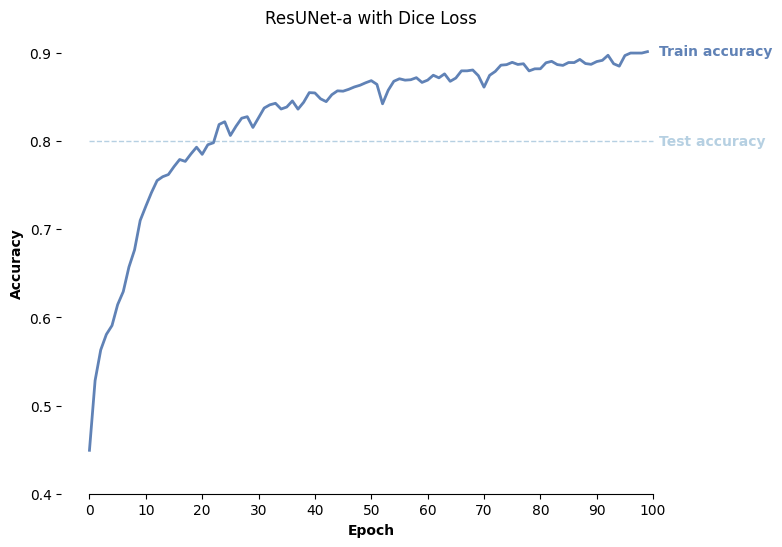

In [22]:
fig, ax = plt.subplots(figsize=(8, 6))

ax.plot(
    [0, EPOCHS], 
    [mean_test_acc, mean_test_acc],
    label="Test accuracy",
    color="#B6D0E2",
    linestyle="--",
    linewidth=1,
)

ax.text(
    EPOCHS * 1.01,
    mean_test_acc,
    "Test accuracy",
    color="#B6D0E2",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.plot(
    acc_list,
    label="Train accuracy",
    color="#6082B6",
    linewidth=2,
)

ax.text(
    EPOCHS * 1.01,
    acc_list[-1],
    "Train accuracy",
    color="#6082B6",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.spines["bottom"].set_bounds(0, EPOCHS)

ax.set_xticks(np.arange(0, EPOCHS + 1, 10))
ax.set_yticks(np.arange(0.4, 1.0, 0.1))

ax.set_xlabel("Epoch", fontweight="bold")
ax.set_ylabel("Accuracy", fontweight="bold")

plt.title('ResUNet-a with Dice Loss')
plt.show()

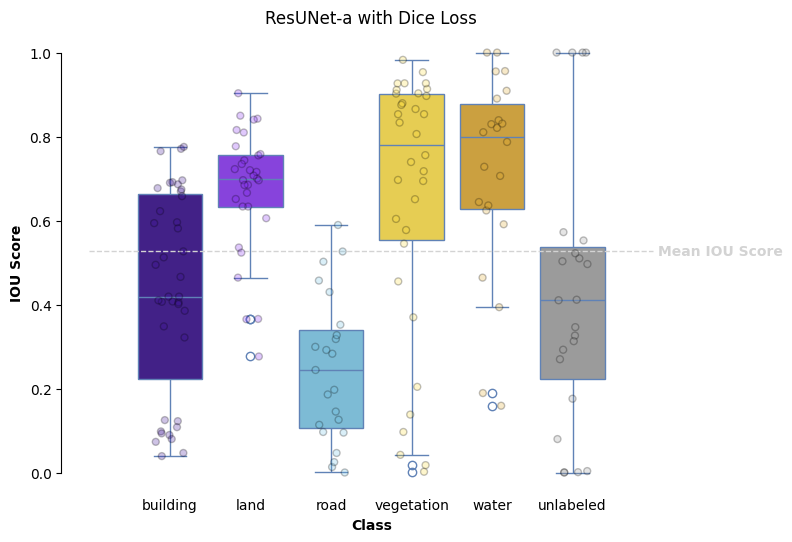

In [29]:
iou_scores = get_iou_by_class(iou_list)

fig, ax = plt.subplots(figsize=(8, 6))

sns.boxplot(
    iou_scores,
    palette=['#3C1098', '#8429F6', '#6EC1E4', '#FEDD3A', '#E2A929', '#9B9B9B'],
    ax=ax,
    linecolor='#6082B6'
)
sns.stripplot(
    iou_scores,
    palette=['#3C1098', '#8429F6', '#6EC1E4', '#FEDD3A', '#E2A929', '#9B9B9B'],
    ax=ax,
    alpha=0.25,
    edgecolor='black',
    linewidth=1,
    jitter=0.2
)
ax.plot(
    [-1, 6], 
    [mean_iou_scores, mean_iou_scores],
    label="Test accuracy",
    color="lightgray",
    linestyle="--",
    linewidth=1,
)
ax.text(
    6 * 1.01,
    mean_iou_scores,
    "Mean IOU Score",
    color="lightgray",
    fontweight="bold",
    horizontalalignment="left",
    verticalalignment="center",
)

ax.set_xticks(range(dataset.num_classes), dataset.mask_labels)
ax.tick_params(axis='x', length=0)

ax.spines["right"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.spines["left"].set_bounds(0, 1)

ax.set_xlabel('Class', fontweight="bold")
ax.set_ylabel('IOU Score', fontweight="bold")

plt.title('ResUNet-a with Dice Loss')
plt.show()